In [54]:
import numpy as np
import argparse
import imutils
import cv2
import time
import os
from os import path
from PIL import Image, ImageEnhance 
from matplotlib import pyplot
from matplotlib.patches import Rectangle
from matplotlib.patches import Circle
from mtcnn.mtcnn import MTCNN
import shutil
import tensorflow as tf
from tensorflow import keras
start_time = time.time()
detector = MTCNN()
import imageio
from multiprocessing import Process
import threading
import concurrent.futures

In [55]:
class FolderFileProcessing:
    
    def createGoodImages(self, root, path):
        if(self.checkDirectory(f'{self.imageReport}good_images/{self.stripRootFolder(path)}') == False):
            self.createDirectory(f'{self.imageReport}good_images/{root}')
        shutil.copy(path, f'{self.imageReport}good_images/{self.stripRootFolder(path)}')
    
    def createBadImages(self, path):
        pass
    
    def createNotSureImages(self, root, path):
        if(self.checkDirectory(f'{self.imageReport}not_sure/{self.stripRootFolder(path)}') == False):
            self.createDirectory(f'{self.imageReport}not_sure/{root}')
        shutil.copy(path, f'{self.imageReport}not_sure/{self.stripRootFolder(path)}')
    
    def createFaceBackground(self, root, path):
        if(self.checkDirectory(f'{self.imageReport}face_in_background/{self.stripRootFolder(path)}') == False):
            self.createDirectory(f'{self.imageReport}face_in_background/{root}')
        shutil.copy(path, f'{self.imageReport}face_in_background/{self.stripRootFolder(path)}')
    
    def createNoHumanFace(self, root, path):
        if(self.checkDirectory(f'{self.imageReport}no_human_face/{self.stripRootFolder(path)}') == False):
            self.createDirectory(f'{self.imageReport}no_human_face/{root}')
        shutil.copy(path, f'{self.imageReport}no_human_face/{self.stripRootFolder(path)}')
        
    def reProcessHumanFace(self, root, path):
        if(self.checkDirectory(f'{self.imageReport}reprocess_images/{self.stripRootFolder(path)}') == False):
            self.createDirectory(f'{self.imageReport}reprocess_images/{root}')
        shutil.copy(path, f'{self.imageReport}reprocess_images/{self.stripRootFolder(path)}')
    
    def createDefaced(self, path):
        pass

In [56]:
class ImageProcessing(FolderFileProcessing):
    get_cwd = os.getcwd()
    imagesPath = f'{get_cwd}/pictures/'
    reprocessPath = f'{get_cwd}/Reports/reprocess_images/'
    imageReport = f'{get_cwd}/Reports/'
    primaryFolders = ['good_images','face_in_background','no_human_face','defaced', 'not_sure', 'reprocess_images']
    re_run=0
    dark_images=0
    
    def __init__(self):
        if path.exists(self.imageReport) == False:
            os.mkdir(self.imageReport)
        else:
            self.deleteDirectories(self.imageReport)
        self.createDirectories(self.primaryFolders)
        
    def checkDirectory(self, _path):
        return path.exists(_path)
    
    def checkLightDark(self, img):
        f = imageio.imread(img, as_gray=True)
        is_light = np.mean(f) > 127
        return ('light' if is_light else 'dark')
    
    def enhanceImage(self, img, num):
        im = Image.open(img)
        enhancer = ImageEnhance.Brightness(im)
        enhanced_im = enhancer.enhance(num)
        enhanced_im.save("./sample.jpg")
    
    def stripRootFolder(self, _path):
        assert _path is not None
        try:
            if(self.imagesPath in _path):
                return _path.replace(self.imagesPath, '')
            else:
                return _path
        except:
            print(f'{self.imagesPath}<==>{_path}')
        
        
    def createDirectory(self, folder):
        fol = self.stripRootFolder(folder)
        if(path.exists(fol)):
            pass
        else:
            try:
                os.makedirs(fol, 0o755, False)
            except OSError:
                pass
        
    def createDirectories(self, arr):
        for folder in arr:
            try:
                os.mkdir(self.imageReport+folder)
            except OSError:
                print ("Creation of the directory %s failed" % folder)
            else:
                print ("Successfully created the directory %s " % folder)
        
    def deleteDirectories(self, path):
        print(f'Attempting to delete...  {path}')
        for filename in os.listdir(path):
            file_path = os.path.join(path, filename)
            try:
                if os.path.isfile(file_path) or os.path.islink(file_path):
                    os.unlink(file_path)
                elif os.path.isdir(file_path):
                    shutil.rmtree(file_path)
                    print(f'Deleted ! {path}')
            except Exception as e:
                print('Failed to delete %s. Reason: %s' % (file_path, e))
                
    
    
    def detectFaceTensorFlow(self, img):
        self.re_run+=1
        imgResult = list()
        image = tf.keras.preprocessing.image.load_img(img, grayscale=False, color_mode='rgb', target_size=None,interpolation='bilinear')
        pixels = keras.preprocessing.image.img_to_array(image)
        pyplot.imshow(image)
        ax = pyplot.gca()
        for result in detector.detect_faces(pixels):
            x, y, width, height = result['box']
            rect = Rectangle((x, y), width, height, fill=False, color='blue')
            imgResult.append(result['confidence']*100)
            ax.add_patch(rect)
            for key, value in result['keypoints'].items():
                dot = Circle(value, radius=3, color='blue')
                ax.add_patch(dot)

        pyplot.show()
        return imgResult

    ## THIS IS THE FIRST LEVEL DETECTION  =>>> THIS IS THE FIRST METHOD THAT THE IMAGE WOULD GO THROUGH
    def detectFaceModel(self,img):
        prototypePath='./face_recognition/face_detection_model/deploy.prototxt'
        modelPath='./face_recognition/face_detection_model/res10_300x300_ssd_iter_140000.caffemodel'
        confidenceParam=0.5
        protoPath = prototypePath
        modelPath = modelPath 
        detector = cv2.dnn.readNetFromCaffe(protoPath, modelPath)
        detectionResult = list()
        image = cv2.imread(img)
        image = imutils.resize(image, width=350)
        (h, w) = image.shape[:2]

        # construct a blob from the image
        imageBlob = cv2.dnn.blobFromImage(
            cv2.resize(image, (250, 250)), 1.0, (250, 250),
            (104.0, 177.0, 123.0), swapRB=False, crop=False)

        # apply OpenCV's deep learning-based face detector to localize
        # faces in the input image
        detector.setInput(imageBlob)
        detections = detector.forward()

        # loop over the detections
        for i in range(0, detections.shape[2]):
            # extract the confidence (i.e., probability) associated with the
            # prediction
            confidence = detections[0, 0, i, 2]

            # filter out weak detections
            if confidence > 0.5:
            # compute the (x, y)-coordinates of the bounding box for the
                # face
                box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
                (startX, startY, endX, endY) = box.astype("int")

                # extract the face ROI
                face = image[startY:endY, startX:endX]
                (fH, fW) = face.shape[:2]

                # ensure the face width and height are sufficiently large
                if fW < 20 or fH < 20:
                    continue

                # draw the bounding box of the face along with the associated
                # probability
                text = (confidence * 100)
                detectionResult.append(text)
        return detectionResult

    ## THIS IS THE SECOND LEVEL DETECTION  =>>> THIS IS THE SECOND METHOD THAT THE IMAGE WOULD GO THROUGH                    
    def detectFaceTensorFlow2nd(self, img):
        imgResult = list()
        pixels = pyplot.imread(img)
        faces = detector.detect_faces(pixels)
        pyplot.imshow(pixels)
        ax = pyplot.gca()
        for result in faces:
            x, y, width, height = result['box']
            rect = Rectangle((x, y), width, height, fill=False, color='blue')
            imgResult.append(result['confidence']*100)
            ax.add_patch(rect)
            for key, value in result['keypoints'].items():
                dot = Circle(value, radius=3, color='blue')
                ax.add_patch(dot)

        pyplot.show()
        return imgResult

    def classifyImages(self):
        print('Classifying faces in images...')
        good=0 
        anotherface=0 
        no_human_face=0
        not_sure =0
        reprocess_images = 0
        for root, directories, files in os.walk(self.imagesPath, topdown=False):
            for image in files: # or ('.jpg' in image) or ('.jpeg' in image)
                if(('.jpg' in image) or ('.jpeg' in image)):
                    lightDark = self.checkLightDark(f'{root}/{image}')
                    if(lightDark == 'dark'):
                        self.dark_images+=1
                        self.enhanceImage(f'{root}/{image}', 2.5)
                        result = self.detectFaceModel("./sample.jpg")
                    else:
                        result = self.detectFaceModel(f'{root}/{image}')
                    
                    #GOOD IMAGES CLASSIFIED AS 95 FOR FIRST CHECK 
                    if(len(result) == 1 and result[0] > 75):
                        good+=1
                        self.createGoodImages(root, f'{root}/{image}')
                        
                    #IMAGES WITH ANOTHER FACE CHECK CLASSIFIED BELOW 75 THEN RUN OTHER CHECKS
                    elif(len(result)>1 and result[0] <75):
                        tempResult = self.detectFaceTensorFlow(f'{root}/{image}')
                        if(len(tempResult)>0):
                            if(len(tempResult)== 1 and result[0] > tempResult[0]):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            elif(tempResult[0] > result[0] and len(tempResult) == 1):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            else:
                                no_human_face+=1
                                self.createNoHumanFace(root, f'{root}/{image}')
                    
                    #IMAGES WITH ANOTHER FACE CHECK CLASSIFIED ABOVE 95 THEN RUN OTHER CHECKS
                    elif(len(result) > 1 and result[1] > 85):
                        tempResult = self.detectFaceTensorFlow(f'{root}/{image}')
                        if(len(tempResult) > 0):
                            if(tempResult[0] > 75):
                                good +=1
                                self.createGoodImages(root,f'{root}/{image}')
                            elif(len(tempResult) > 1):
                                anotherface += 1
                                self.createFaceBackground(root, f'{root}/{image}')
                            elif(tempResult[0] > 10 and tempResult[0] < 50):
                                not_sure += 1
                                self.createNotSureImages(root, f'{root}/{image}')
                            else:
                                no_human_face += 1
                                self.createNoHumanFace(root, f'{root}/{image}')
                                
                        elif(result[0] > 75 and len(tempResult) == 0):
                                good += 1
                                self.createGoodImages(root, f'{root}/{image}')
                        else:
                            anotherface+=1
                            self.createFaceBackground(root, f'{root}/{image}')
                    
                    #IMAGES WITH FIRST DETECTION AS TWO FACE BUT NEXT DETECTION AS ONE FACE
                    elif(len(result) > 1 and result[0] > 75):
                        tempResult = self.detectFaceTensorFlow(f'{root}/{image}')
                        if(len(result)>1 and len(tempResult)>1):
                            anotherface+=1
                            self.createFaceBackground(root, f'{root}/{image}')
                        elif(len(tempResult)>0):
                            if(tempResult[0] > 75):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            elif(result[0] > tempResult[0]):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            elif(tempResult[0] > result[0]):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            else:
                                not_sure+=1
                                self.createNotSureImages(root, f'{root}/{image}')
                        elif(result[0] > 50):
                            good+=1
                            self.createGoodImages(root, f'{root}/{image}')  
                        elif(result[0] > 10 and result[0] < 50):
                            not_sure+=1
                            self.createNotSureImages(root, f'{root}/{image}')  
                        else:
                            no_human_face+=1
                            self.createNoHumanFace(root,f'{root}/{image}')
                            
                     
                    #NO FACE AT ALL       
                    elif(len(result) == 0):
                        reprocess_images+=1
                        self.reProcessHumanFace(root, f'{root}/{image}')
                        pass
                            
                    else:
                        tempResult = self.detectFaceTensorFlow(f'{root}/{image}')
                        if(len(tempResult)>0):
                            if(tempResult[0] > 75):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            elif(tempResult[0] > result[0]):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                            elif(result[0] > tempResult[0]):
                                good+=1
                                self.createGoodImages(root, f'{root}/{image}')
                                
                        elif(result[0] > 50):
                            good+=1
                            self.createGoodImages(root, f'{root}/{image}')  
                        elif(result[0] > 10 and result[0] < 50):
                            not_sure+=1
                            self.createNotSureImages(root, f'{root}/{image}')  
                        else:       
                            no_human_face+=1
                            self.createNoHumanFace(root, f'{root}/{image}')
                    
        print('good: ', good, '| anotherface: ', anotherface, '| notsure: ', not_sure, '| no human face: ',
              no_human_face,  '| Reverification needed:  ',reprocess_images,  '| Reprocessed: ', self.re_run, '| Dark Images: ', self.dark_images, '\n')
        print(f'------ {time.time()-start_time} -----\n')
        
    def initiateThreading(self):
        with concurrent.futures.ThreadPoolExecutor(max_workers=4) as executor:
            executor.submit(self.verifyReprocessingImages())
            
    def initiateBlurryImages(self):
        pass
    
    def verifyReprocessingImages(self):
        start_time = time.time()
        print('----- INITIATE VERIFICATION OF NEED TO BE REPROCESSED IMAGES  ------\n')
        for root, directories, files in os.walk(self.reprocessPath, topdown=False):
            for image in files:
                if(('.jpg' in image) or ('.jpeg' in image)):
                    tempResult = self.detectFaceTensorFlow(f'{root}/{image}')
                    if(len(tempResult)>0):
                        if(tempResult[0] > 50):
                            good+=1
                            self.createGoodImages(root, f'{root}/{image}')
                        elif(len(tempResult) > 1):
                            anotherface+=1
                            self.createFaceBackground(root, f'{root}/{image}')
                        else:
                            not_sure+=1
                            self.createNotSureImages(root, f'{root}/{image}')

                    elif(len(tempResult) ==0):
                        case = ''
                        percent = 0
                        for c in [1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5]:
                            self.enhanceImage(root+'/'+image, c)
                            _result = self.detectFaceTensorFlow("./sample.jpg")
                            print(_result, 'first=>   ',c)
                            if(len(_result)>0):
                                if(_result[0]>50):
                                    case='good'
                                    percent=_result[0]
                                    break
                                elif(_result[0] > 10 and _result[0] < 50):
                                    case='not_sure'
                                    percent=_result[0]
                                    break
                                else:
                                    __result = self.detectFaceModel("./sample.jpg")
                                    print(__result, 'second=>   ',c)
                                    if(len(__result)>0):
                                        if(__result[0]>50):
                                            case='good'
                                            percent=__result[0]
                                            break
                                        elif(__result[0] > 10 and __result[0] < 50):
                                            case='not_sure'
                                            percent=__result[0]
                                            break
                                    else:
                                        case='no_human_face'
                                        percent=0
                                        break
                            else:
                                case='no_human_face'
                                percent=0
                                break

                        print(percent)
                        print(case)
                        
        print('------ ',time.time()-start_time,' -----\n')
                        


In [57]:
imageProcessing = ImageProcessing()

Attempting to delete...  C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Deleted ! C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Deleted ! C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Deleted ! C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Deleted ! C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Deleted ! C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Deleted ! C:\Users\Genesis\Documents\projectImageRecognition\imageclassification-master/Reports/
Successfully created the directory good_images 
Successfully created the directory face_in_background 
Successfully created the directory no_human_face 
Successfully created the directory defaced 
Successfully created the directory not_sure 
Successfully created the directory reprocess_images 


Classifying faces in images...


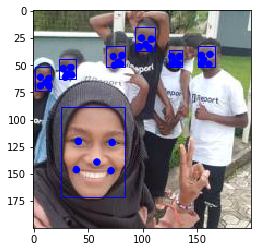

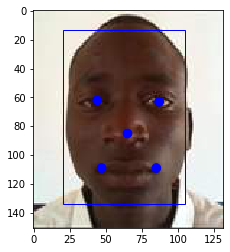

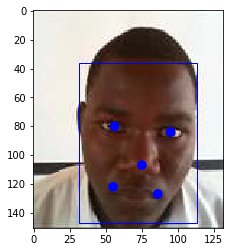

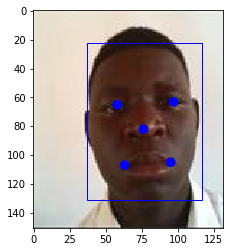

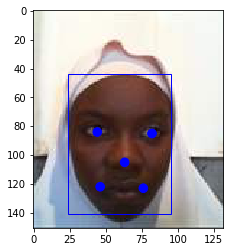

...

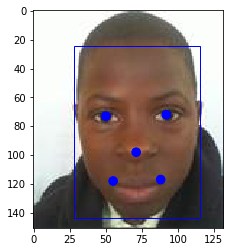

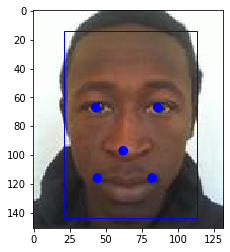

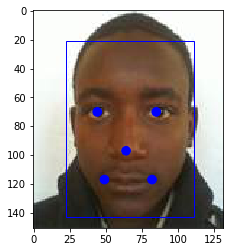

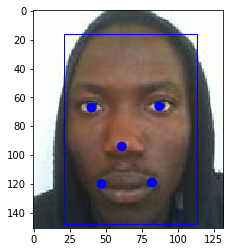

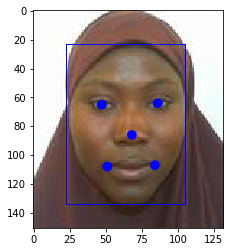

good:  3558 | anotherface:  1 | notsure:  0 | no human face:  0 | Reverification needed:   3 | Reprocessed:  797 | Dark Images:  286 

------ 764.4763684272766 -----



In [58]:
imageProcessing.classifyImages()